# MOSELEY PINN

The previous notebook showed that it is possible for an MLP to learn decently the acoustic wave equation for one timestep. The goal of this notebook is to see if the first 10 timesteps can be approximated with an MLP. In the beginning the source term is not negligible, the last time step will act as the boudary loss for the PINN

In this model, the minibatch gradient descent is used instead of the full gradient descent simply because of computational power, the number of samples used for the training doesn't fit on the GPU

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import h5py
from pyDOE import lhs
from itertools import cycle

In [2]:
# Pytorch Model Name
model_name = 'Moseley_PINN_100000.pt'

# Load Salvus data
path = "../../NoCrack/Simple_Homogeneous_Moseley/Event0000/output.h5"
hf = h5py.File(path, 'r')

In [3]:
# Test data
timestep = 40

df_test = pd.DataFrame()
df_test['X'] = hf['coordinates_ACOUSTIC'][:,0][:,0].astype(float)
df_test['Y'] = hf['coordinates_ACOUSTIC'][:,0][:,1].astype(float)
df_test['T'] = timestep * 0.002
df_test['True'] = hf['volume']['phi'][timestep][:,0].mean(axis=1)

In [4]:
# Training data
df_train = pd.DataFrame()

for ts in range(0,timestep+1,4):
    print('ts',ts)
    df_ts = pd.DataFrame()
    df_ts['X'] = hf['coordinates_ACOUSTIC'][:,0][:,0].astype(float)
    df_ts['Y'] = hf['coordinates_ACOUSTIC'][:,0][:,1].astype(float)
    df_ts['T'] = 0.002*ts
    df_ts['True'] = hf['volume']['phi'][ts][:,0].mean(axis=1)

    df_train = pd.concat((df_train,df_ts),axis=0)
df_train = df_train.reset_index(drop=True)

ts 0
ts 4
ts 8
ts 12
ts 16
ts 20
ts 24
ts 28
ts 32
ts 36
ts 40


In [5]:
print('Training data shape :',df_train.shape)

Training data shape : (990000, 4)


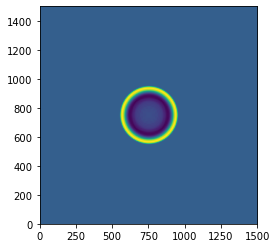

In [6]:
# Pivot Table to reorder the data
df_show = df_test.pivot_table(values='True',index='Y',columns='X').sort_index(axis=0,ascending=False)

# Plot
plt.imshow(df_show.values,extent=[0,1500,0,1500])

## Data

In [7]:
# Boundary conditions - the first timesteps from 0.00 to 0.08 - 500 samples sampled at every epoch
N_f = 500

idx = np.random.choice(df_train.shape[0], N_f)

df_train.loc[idx,:].values

x_train = df_train.loc[idx,:].values[:,:1]
y_train = df_train.loc[idx,:].values[:,1:2]
t_train = df_train.loc[idx,:].values[:,2:3]
p_train = df_train.loc[idx,:].values[:,3:4]

# Residuals - the data from 0.00 to 0.2
N_f = 500

MAX_T = 100 * 0.002

lb = np.array([0.0, 0.0, 0.0])
ub = np.array([ 1500.0,  1500.0, MAX_T])

residuals = lb + (ub - lb) * lhs(3, N_f)

xf_train = residuals[:,:1]
yf_train = residuals[:,1:2]
tf_train = residuals[:,2:3]

In [8]:
MAX_T = 200 * 0.002

lb = np.array([0.0, 0.0, 0.0])
ub = np.array([ 1500.0,  1500.0, MAX_T])

In [9]:
# Initial condition point for u, v, ut, vt

#IC = DelSrcPT(IC, xc=0, yc=0, r=2.0)

# Border conditions
LW = np.array([0.0, 0.0, 0.0]) + np.array([1500.0, 0.0, MAX_T]) * lhs(3, 100)

UP = np.array([0.0,  1500.0, 0.0]) + np.array([1500.0, 0.0, MAX_T]) * lhs(3, 100)

LF = np.array([0.0, 0.0, 0.0]) + np.array([0.0, 1500.0, MAX_T]) * lhs(3, 100)

RT = np.array([ 1500.0, 0.0, 0.0]) + np.array([0.0, 1500.0, MAX_T]) * lhs(3, 100)

FIXED = np.concatenate((LF, RT, LW, UP), 0)

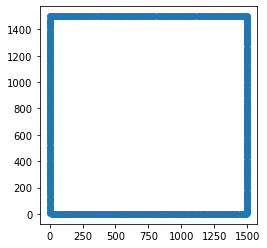

In [10]:
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.scatter(FIXED[:,0],FIXED[:,1])
plt.show()

In [11]:
# Collocation points to compute the residuals
xc_src = 750
yc_src = 750

# Num of collocation point in x, y, t
N_f = 20000

XYT_c = lb + (ub - lb) * lhs(3, N_f)

XYT_c_ext = np.array([xc_src - 200/2 , yc_src - 200/2, 0.0]) + np.array([200, 200, MAX_T]) * lhs(3, 100000)

XYT_c_ext2 = lb + (ub - lb) * lhs(3, 20000)

flag = (np.abs(XYT_c_ext2[:,0] - xc_src)>700)|(np.abs(XYT_c_ext2[:,1] - yc_src)>700)

XYT_c_ext2 = XYT_c_ext2[flag,:]

XYT_c = np.concatenate((XYT_c, XYT_c_ext, XYT_c_ext2),axis=0)

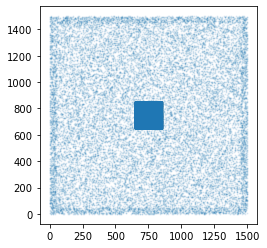

In [12]:
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.scatter(XYT_c[:,0:1], XYT_c[:,1:2], marker='o', alpha=0.1, s=1)

In [13]:
# Collocation points with known value of the pressure
df_coloc = df_train.loc[(np.abs(df_train['X'] - xc_src) <= 100)&(np.abs(df_train['Y'] - yc_src)<=100),:].reset_index(drop=True)

idx = np.random.choice(df_coloc.shape[0], N_f)

df_coloc = df_coloc.loc[idx].reset_index(drop=True)

(0.0, 1500.0)

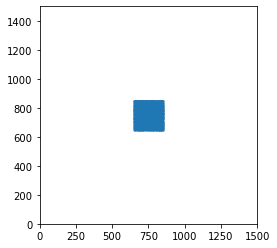

In [14]:
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.scatter(df_coloc.values[:,0:1], df_coloc.values[:,1:2], marker='o', alpha=0.1, s=1)
ax.set_xlim(0,1500)
ax.set_ylim(0,1500)

## Model

In [15]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

from model import *
from model_wave_pinn import *

In [16]:
# CUDA support 
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [17]:
class u_dataset(Dataset):
    def __init__(self, inputs, outputs):
        super(Dataset, self).__init__()

        self.inputs = inputs
        self.outputs = outputs

    def __len__(self):
        return self.inputs.shape[0]
        
    def __getitem__(self, index):

        # X 
        X = self.inputs[index, :]

        y = self.outputs[index]
        return X, y

In [18]:
class f_dataset(Dataset):
    def __init__(self, inputs):
        super(Dataset, self).__init__()

        self.inputs = inputs

    def __len__(self):
        return self.inputs.shape[0]
        
    def __getitem__(self, index):

        # X 
        X = self.inputs[index, :]

        return X

In [19]:
def train(model,data_dict,loss_fn,optimizer,epochs):
    
    model = model.to(device)

    net_u = Net_U(model=model)
    net_f = Net_F(net_u=net_u,nu=1400)

    train_dataset_u = u_dataset(data_dict['X_train'],data_dict['y_train']) # For know points
    train_dataset_f = f_dataset(data_dict['X_train_f']) # For residuals points

    trainloader_u = DataLoader(train_dataset_u, batch_size=10000, shuffle=True, num_workers=0)
    trainloader_f = DataLoader(train_dataset_f, batch_size=10000, shuffle=True, num_workers=0)

    tot_loss = []
    tot_loss_u = []
    tot_loss_f = [] 

    for epoch in range(epochs):
        model.train()

        epoch_loss = 0
        epoch_loss_u = 0
        epoch_loss_f = 0

        for i, ((X, true),(X_f)) in enumerate(zip(cycle(trainloader_u),trainloader_f)):

            #print(X.shape)
            #print(true.shape)
            #print(X_f.shape)

            x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device)
            y = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)
            t = torch.tensor(X[:, 2:3], requires_grad=True).float().to(device)

            true = torch.tensor(true).float().to(device)

            x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
            y_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)
            t_f = torch.tensor(X_f[:, 2:3], requires_grad=True).float().to(device)

            optimizer.zero_grad()

            preds_u = net_u(x, y, t)
            preds_f = net_f(x_f, y_f, t_f)

            loss, loss_u, loss_f = loss_fn(true,preds_u,preds_f)

            loss.backward()
            optimizer.step()

            epoch_loss += loss.data.item()
            epoch_loss_u += loss_u.data.item()
            epoch_loss_f += loss_f.data.item()

        tot_loss.append(epoch_loss)
        tot_loss_u.append(epoch_loss_u)
        tot_loss_f.append(epoch_loss_f)

        if epoch % 10 == 0:
                print('Iter %d, Loss: %.5e, Loss u: %.5e, Loss f: %.5e' % (epoch,epoch_loss,epoch_loss_u,epoch_loss_f))

    loss_dict = {}
    loss_dict['loss'] = tot_loss
    loss_dict['loss_u'] = tot_loss_u
    loss_dict['loss_f'] = tot_loss_f

    return model, loss_dict

In [20]:
def plots(df_data):
    # Compute error :
    df_data['Error'] = df_data['Preds']-df_data['True']

    # Plot :
    fig, ax = plt.subplots(1,3,figsize=(16,4))

    im = ax[0].imshow(df_data.pivot_table(values='Preds',index='Y',columns='X').sort_index(axis=0,ascending=False))
    ax[0].set_title('Prediction')
    fig.colorbar(im, ax=ax[0])

    im = ax[1].imshow(df_data.pivot_table(values='True',index='Y',columns='X').sort_index(axis=0,ascending=False))
    ax[1].set_title('True')
    fig.colorbar(im, ax=ax[1])

    im = ax[2].imshow(df_data.pivot_table(values='Error',index='Y',columns='X').sort_index(axis=0,ascending=False))
    ax[2].set_title('Error')
    fig.colorbar(im, ax=ax[2])

    plt.show()

In [21]:
model = Model(in_size=3)

loss_fn = PINN_loss()

optimizer = torch.optim.Adam(model.parameters(),lr = 1e-5)

In [22]:
model = model.to(device)

net_u = Net_U(model=model)
net_f = Net_F(net_u=net_u,nu=1400)

In [23]:
epoch = 100000

for i in range(epoch):
    model.train()

    # Boundary conditions - the first timesteps from 0.00 to 0.08 - 500 samples sampled at every epoch
    N_f = 500

    idx = np.random.choice(df_train.shape[0], N_f)

    df_train.loc[idx,:].values

    x_train = torch.tensor(df_train.loc[idx,:].values[:,:1], requires_grad=True).float().to(device)
    y_train = torch.tensor(df_train.loc[idx,:].values[:,1:2], requires_grad=True).float().to(device)
    t_train = torch.tensor(df_train.loc[idx,:].values[:,2:3], requires_grad=True).float().to(device)
    p_train = torch.tensor(df_train.loc[idx,:].values[:,3:4], requires_grad=True).float().to(device)

    # Residuals - the data from 0.00 to 0.2 - 500 samples sampled at every epoch
    N_f = 500

    MAX_T = 100 * 0.002

    lb = np.array([0.0, 0.0, 0.0])
    ub = np.array([ 1500.0,  1500.0, MAX_T])

    residuals = lb + (ub - lb) * lhs(3, N_f)

    xf_train = torch.tensor(residuals[:,:1], requires_grad=True).float().to(device)
    yf_train = torch.tensor(residuals[:,1:2], requires_grad=True).float().to(device)
    tf_train = torch.tensor(residuals[:,2:3], requires_grad=True).float().to(device)

    optimizer.zero_grad()

    preds_u = net_u(x_train, y_train, t_train)
    preds_f = net_f(xf_train, yf_train, tf_train)

    loss, loss_u, loss_f = loss_fn(p_train,preds_u,preds_f)
    
    loss.backward()
    optimizer.step()

    if i % 1000 == 0:
        print('Iter %d, Loss: %.5e, Loss u: %.5e, Loss f: %.5e' % (i,loss,loss_u,loss_f))



Iter 0, Loss: 9.95867e+00, Loss u: 9.95867e+00, Loss f: 3.52994e-06
Iter 1000, Loss: 1.73600e+01, Loss u: 1.73600e+01, Loss f: 4.37545e-06
Iter 2000, Loss: 2.82540e+01, Loss u: 2.82540e+01, Loss f: 4.40745e-06
Iter 3000, Loss: 1.95167e+01, Loss u: 1.95167e+01, Loss f: 4.60128e-06
Iter 4000, Loss: 2.60713e+01, Loss u: 2.60713e+01, Loss f: 3.26622e-06
Iter 5000, Loss: 1.16752e+01, Loss u: 1.16752e+01, Loss f: 5.57129e-06
Iter 6000, Loss: 1.06416e+01, Loss u: 1.06416e+01, Loss f: 5.26195e-06
Iter 7000, Loss: 6.79591e+01, Loss u: 6.79591e+01, Loss f: 6.53243e-06
Iter 8000, Loss: 5.01912e+01, Loss u: 5.01912e+01, Loss f: 6.53409e-06
Iter 9000, Loss: 1.05089e+01, Loss u: 1.05089e+01, Loss f: 5.12506e-06
Iter 10000, Loss: 2.86448e+01, Loss u: 2.86448e+01, Loss f: 3.42522e-06
Iter 11000, Loss: 2.63288e+01, Loss u: 2.63288e+01, Loss f: 4.86353e-06
Iter 12000, Loss: 3.44825e+01, Loss u: 3.44825e+01, Loss f: 4.92180e-06
Iter 13000, Loss: 7.41334e+00, Loss u: 7.41334e+00, Loss f: 5.01755e-06
Iter 

In [110]:
# Save model
PATH = model_name

torch.save(model_train.state_dict(), PATH)

In [111]:
def prediction(model,X_test,y_test,device):

    model = model.to(device)
    x = torch.tensor(X_test[:, 0:1], requires_grad=True).float().to(device)
    y = torch.tensor(X_test[:, 1:2], requires_grad=True).float().to(device)
    t = torch.tensor(X_test[:, 2:3], requires_grad=True).float().to(device)

    true = torch.tensor(y_test).float().to(device)

    model.eval()
    with torch.no_grad():

        preds = model(torch.cat([x, y, t], dim=1))

    preds = preds.detach().cpu().numpy()
    return preds

In [112]:
#df_test[['X','Y','T','True']] = scaler.transform(df_test[['X','Y','T','True']])

X_test = df_test.loc[:,['X','Y','T']].values
y_test = df_test.loc[:,['True']].values

In [113]:
# Load model
PATH = model_name

model_test = Model()
model_test.load_state_dict(torch.load(PATH))
model_test.eval()

Model(
  (layers): ModuleList(
    (0): Linear(in_features=3, out_features=100, bias=True)
    (1): Linear(in_features=100, out_features=100, bias=True)
  )
  (out): Linear(in_features=100, out_features=1, bias=True)
  (tanh): Tanh()
)

In [114]:
preds = prediction(model_test,X_test,y_test,device)

In [115]:
df_test['Preds'] = preds

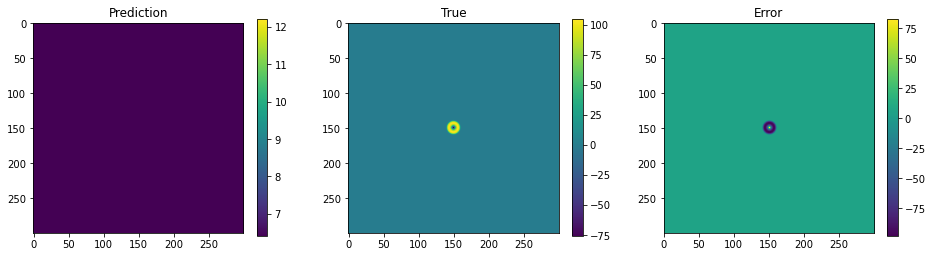

In [116]:
plots(df_test)